# Project: Real Estate Market Analysis

## I. Business Understanding

### Questions

Questions to be addressed during the project:
- How large is the dataset? How many instances and how many columns?
- How many missing values are there in each column?
- How is the distribution of each variable?
- How are the numerical variables correlated? What type of graph will be convenient to present this information? What will be the best predictors of the variable of interest?
- What are the most expensive areas for the purchase of a real estate in Buenos Aires?

The goal of this project is to apply data transformations and advanced model training to further develop a Machine Learning model. The project consists of three sections:
* In Part 1, data transformations were applied through:
1. Outliers detection and removal
2. Encoding
3. Imputation of missing values
4. Data scaling
5. Generation of new predictor variables/dimensionality reduction (PCA).
* In Part 2, three advanced Machine Learning models were developed using cross-validation and hyperparameter optimization using Grid Search and Random Search:
1. Linear regression with polynomial attributes and Ridge regularization
2. Random Forest Regressor
3. XGBoost Regressor
* In Part 3, an analysis of the most relevant variables for the previously implemented models was performed. An analysis of the error distribution was also performed.
* Additionally, a clustering technique was implemented for the latitude and longitude variables of the dataset.

### Importing libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import plotting
from matplotlib.ticker import ScalarFormatter
from matplotlib import gridspec
sns.set()
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objs as go
import scipy as sp
from scipy import stats
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.datasets.loaders import load_nfl
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import preprocessing
from sklearn.feature_selection import RFE
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import classification_report
import xgboost as xgb
import math
from dfply import *
from prettytable import PrettyTable
# Read an image from a remote url.
from PIL import Image
import requests
from io import BytesIO

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import PolynomialFeatures

### Loading Dataset

In [3]:
properati =  pd.read_csv('DS_Proyecto_01_Datos_Properati.csv')

In [4]:
properati.columns

Index(['start_date', 'end_date', 'created_on', 'lat', 'lon', 'l1', 'l2', 'l3',
       'rooms', 'bedrooms', 'bathrooms', 'surface_total', 'surface_covered',
       'price', 'currency', 'title', 'description', 'property_type',
       'operation_type'],
      dtype='object')

In [5]:
# Attribute dictionary
atrib = PrettyTable()
atrib.field_names = ["Attribute", "Description"]
atrib.add_row(["start_date", "date on which the property entered the website"])
atrib.add_row(["end_date"  , "date of notice termination"])
atrib.add_row(["created_on", "date of registration of the first version of the notice"])
atrib.add_row(["lat", "latitude"])
atrib.add_row(["lon", "longitude"])
atrib.add_row(["l1", "administrative level 1: country"])
atrib.add_row(["l2", "administrative level 2: usually province"])
atrib.add_row(["l3", "administrative level 3: usually city"])
atrib.add_row(["rooms", "number of rooms"])
atrib.add_row(["bedrooms", "number of bedrooms"])
atrib.add_row(["bathrooms", "number of bathrooms"])
atrib.add_row(["surface_total", "total area in m²"])
atrib.add_row(["surface_covered", "surface covered in m²"])
atrib.add_row(["price", "price published in the advertisement"])
atrib.add_row(["currency", "currency in which the publication is denominated"])
atrib.add_row(["title", "title of the advertisement"])
atrib.add_row(["description", "description of the advertisement"])
atrib.add_row(["property_type", "type of property (House, Apartment, PH, etc)"])
atrib.add_row(["operation_type", "type of operation (Sale, Rental)"])
print(atrib)

+-----------------+---------------------------------------------------------+
|    Attribute    |                       Description                       |
+-----------------+---------------------------------------------------------+
|    start_date   |      date on which the property entered the website     |
|     end_date    |                date of notice termination               |
|    created_on   | date of registration of the first version of the notice |
|       lat       |                         latitude                        |
|       lon       |                        longitude                        |
|        l1       |             administrative level 1: country             |
|        l2       |         administrative level 2: usually province        |
|        l3       |           administrative level 3: usually city          |
|      rooms      |                     number of rooms                     |
|     bedrooms    |                    number of bedrooms       

## II. Data Understanding

### Access and Explore

In [6]:
print('The dataset has', properati.shape[0], 'rows and', properati.shape[1], 'columns.')

The dataset has 146660 rows and 19 columns.


In [7]:
properati.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,136735.000000,136701.000000,146660.000000,146660.000000,140703.000000,126133.000000,125046.000000,1.466600e+05
mean,-34.604896,-58.465304,3.079817,1.983240,1.599994,216.872888,112.818011,2.412211e+05
std,0.468428,0.486190,1.416352,1.151304,0.889324,2037.606649,916.857584,3.185195e+05
min,-35.318457,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,5.500000e+03
25%,-34.627667,-58.504012,2.000000,1.000000,1.000000,52.000000,47.000000,1.110000e+05
50%,-34.600943,-58.443262,3.000000,2.000000,1.000000,78.000000,68.000000,1.660000e+05
75%,-34.574600,-58.407586,4.000000,3.000000,2.000000,140.000000,108.000000,2.650000e+05
max,85.051129,-57.805832,35.000000,15.000000,14.000000,193549.000000,126062.000000,3.243423e+07


In [8]:
# Missing values
print('Missing values per column')
properati.isnull().sum().sort_values(ascending = False)

Missing values per column


surface_covered    21614
surface_total      20527
lon                 9959
lat                 9925
bathrooms           5957
start_date             0
property_type          0
description            0
title                  0
currency               0
price                  0
bedrooms               0
end_date               0
rooms                  0
l3                     0
l2                     0
l1                     0
created_on             0
operation_type         0
dtype: int64

According to the analysis of missing values per column, it is evident that the surface_covered attribute has 21614 missing values, being the attribute with the highest number of null fields.

In [9]:
# Percentage of missing values
print('Percentage of missing values per column')
round(properati.isnull().sum().sort_values(ascending=False)*100/len(properati),2)

Percentage of missing values per column


surface_covered    14.74
surface_total      14.00
lon                 6.79
lat                 6.77
bathrooms           4.06
start_date          0.00
property_type       0.00
description         0.00
title               0.00
currency            0.00
price               0.00
bedrooms            0.00
end_date            0.00
rooms               0.00
l3                  0.00
l2                  0.00
l1                  0.00
created_on          0.00
operation_type      0.00
dtype: float64

The percentage of missing values is less than 15%. Taking into account the criterion of keeping those data with less than 30% of mising values, we will proceed to impute them later. 

In [10]:
# Property types
print('Number of property types', properati['property_type'].value_counts().count())
properati['property_type'].value_counts()

Number of property types 10


Departamento       107326
Casa                21521
PH                  14298
Lote                 1312
Oficina               658
Otro                  374
Local comercial       325
Casa de campo         322
Depósito              265
Cochera               259
Name: property_type, dtype: int64

According to the previous analysis, there are ten types of properties within the data set. In the same way, it is determined that the largest number corresponds to Department, which has 107,326 instances.

<AxesSubplot:xlabel='property_type', ylabel='count'>

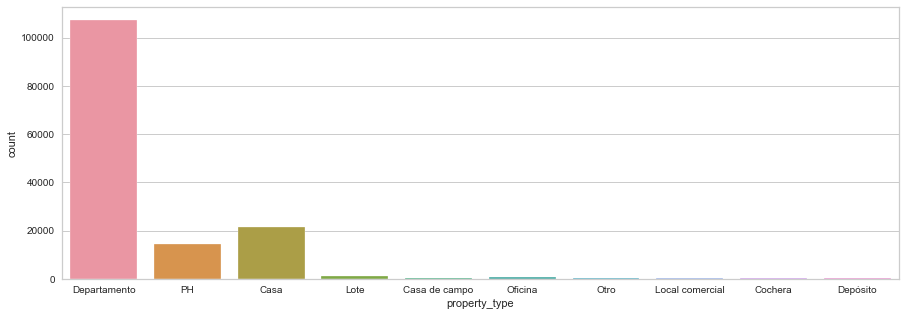

In [11]:
plt.figure(figsize=(15,5))
sns.countplot(data = properati, x = "property_type", orient= 'h')

Since the Department accumulates the largest number of instances compared to the other types of properties, these cannot be visualized clearly, so we proceed to visualize the same graph using a logarithmic scale as shown below.

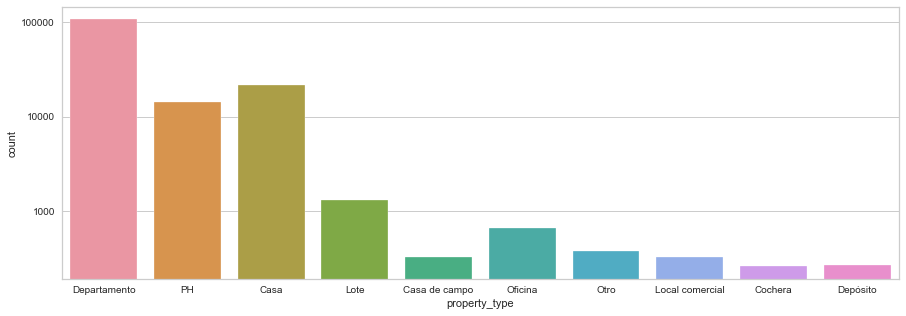

In [12]:
plt.figure(figsize = (15,5))
plt.yscale('log')
plt.gca().yaxis.set_major_formatter(ScalarFormatter())
ax = sns.countplot(data =  properati, x = "property_type")
ax.set_xticklabels(ax.get_xticklabels(), rotation = 0, ha = "center")
plt.show()

It can be observed that both "Apartment", "House" and "PH" are the most abundant within the variable "property_type", drawing differences of more than 10x the other types of properties.

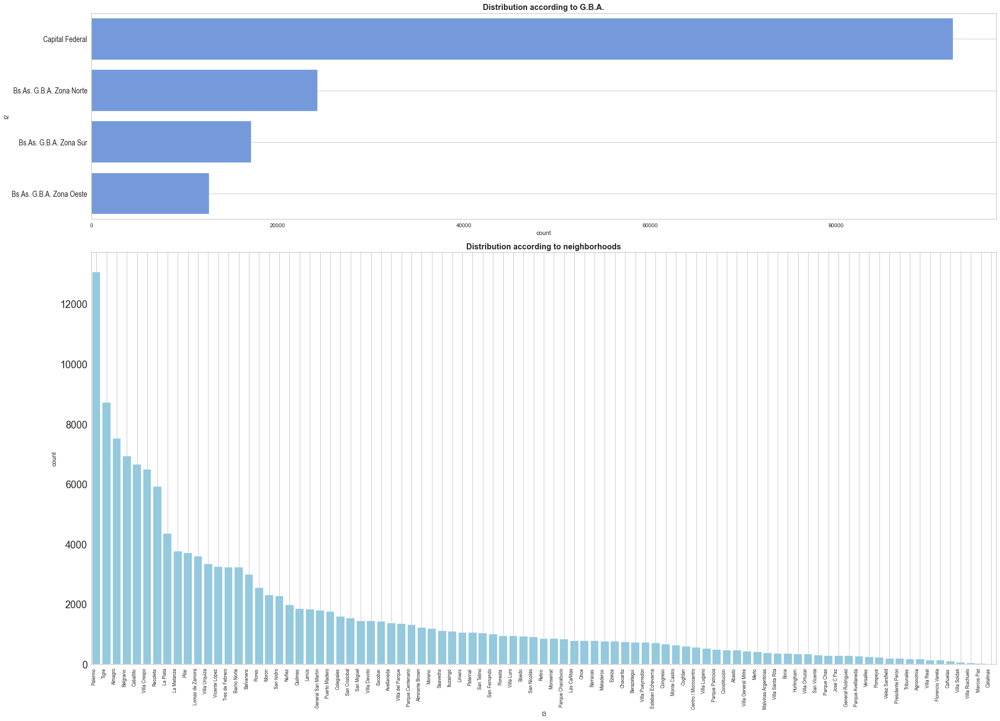

In [13]:
# Regions of application
fig  = plt.figure(figsize = (25,18), constrained_layout = True)
grid = gridspec.GridSpec(2, 1, height_ratios = [1, 2], figure = fig)
ax1 = plt.subplot(grid[0])
sns.countplot(data = properati, y ="l2", order = properati["l2"].value_counts().index, ax = ax1, color = "cornflowerblue")
ax1.set_yticklabels(ax1.get_yticklabels(), fontsize = "large", weight = 'roman', stretch = 'condensed')
ax1.set_title("Distribution according to G.B.A.", fontsize = 'large', weight = 'bold')
ax2 = plt.subplot(grid[1])
sns.countplot(data = properati, x = "l3", order = properati["l3"].value_counts().index, ax = ax2, color = "skyblue")
ax2.set_title("Distribution according to neighborhoods", fontsize = 'large', weight = 'bold')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation = 90, ha = "right", weight = 'roman',stretch = 'condensed')
plt.yticks(fontsize = 18)
ax1.grid()
ax2.grid()
plt.show()

At a glance, it can be seen that most of the instances are located in the Federal Capital. Likewise, in the number of publications by city, it can be seen that of the seven with the most publications, six belong to the Federal Capital.

## III. Prepare Data

In [14]:
properati['property_type'] = properati['property_type'].replace(['Lote', 'Oficina', 'Local comercial',
                                                                 'Casa de campo', 'Depósito', 'Cochera'],'Otro')

In [15]:
properati['property_type'].value_counts()

Departamento    107326
Casa             21521
PH               14298
Otro              3515
Name: property_type, dtype: int64

According to the previous analysis, it was decided to group the types of properties other than the three most abundant, being 'Lot', 'Office', 'Commercial', 'Country house', 'Storage', 'Garage', in an instance called Others to be taken into account in the analysis.

In [16]:
properati.drop(['start_date', 'end_date', 'created_on', 'l1', 'currency', 'title','description', 'operation_type'], axis = 'columns', inplace=True)

The previous columns were eliminated because their data are not relevant for future analysis.

In [17]:
properati.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,136735.000000,136701.000000,146660.000000,146660.000000,140703.000000,126133.000000,125046.000000,1.466600e+05
mean,-34.604896,-58.465304,3.079817,1.983240,1.599994,216.872888,112.818011,2.412211e+05
std,0.468428,0.486190,1.416352,1.151304,0.889324,2037.606649,916.857584,3.185195e+05
min,-35.318457,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,5.500000e+03
25%,-34.627667,-58.504012,2.000000,1.000000,1.000000,52.000000,47.000000,1.110000e+05
50%,-34.600943,-58.443262,3.000000,2.000000,1.000000,78.000000,68.000000,1.660000e+05
75%,-34.574600,-58.407586,4.000000,3.000000,2.000000,140.000000,108.000000,2.650000e+05
max,85.051129,-57.805832,35.000000,15.000000,14.000000,193549.000000,126062.000000,3.243423e+07


### Outliers detection and removal - Clean ##

**Function to remove outliers**

In [18]:
def remove_outlier(df_in, col_name):
    """Function to remove outliers

    Parameters:
    df_in (dataframe): Pandas dataframe
    col_name (string): column name from the input dataframe

    Returns:
    dataframe:Returning a Pandas dataframe without outliers using statistical method of IQR

   """
    Q1 = df_in[col_name].quantile(0.25)
    Q3 = df_in[col_name].quantile(0.75)
    IQR = Q3-Q1 #Interquartile range
    fence_low  = Q1-(1.5*IQR)
    fence_high = Q3+(1.5*IQR)
    df_out = df_in.drop(df_in[(df_in[col_name] > fence_high) | (df_in[col_name] < fence_low)].index)
    return df_out

**ROOMS - BEDROOMS - BATHROOMS**

Text(0.5, 1.0, 'Bathrooms')

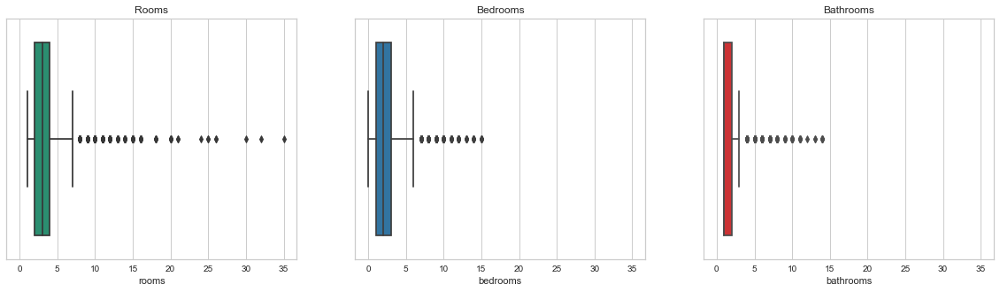

In [19]:
fig, axes = plt.subplots(1,3,sharex=True,figsize=(20,5))

sns.boxplot(ax=axes[0], x=properati['rooms'], palette='Dark2')
axes[0].set_title('Rooms')

sns.boxplot(ax=axes[1], x=properati['bedrooms'], palette='tab10')
axes[1].set_title('Bedrooms')

sns.boxplot(ax=axes[2], x=properati['bathrooms'], palette='Set1')
axes[2].set_title('Bathrooms')

In [20]:
properati = remove_outlier(properati, 'rooms')
properati = remove_outlier(properati, 'bedrooms')
properati = remove_outlier(properati, 'bathrooms')

Text(0.5, 1.0, 'Bathrooms')

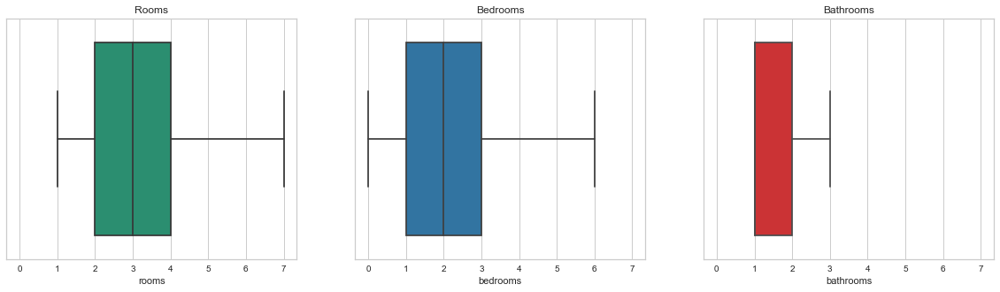

In [21]:
fig, axes = plt.subplots(1,3,sharex=True,figsize=(20,5))

sns.boxplot(ax=axes[0], x=properati['rooms'], palette='Dark2')
axes[0].set_title('Rooms')

sns.boxplot(ax=axes[1], x=properati['bedrooms'], palette='tab10')
axes[1].set_title('Bedrooms')

sns.boxplot(ax=axes[2], x=properati['bathrooms'], palette='Set1')
axes[2].set_title('Bathrooms')

In [22]:
print('Number of Rooms:\n', properati.rooms.value_counts().sort_index())
print('Number of Bedrooms:\n', properati.bedrooms.value_counts().sort_index())
print('Number of Bathrooms:\n', properati.bathrooms.value_counts().sort_index())

Number of Rooms:
 1.0    13083
2.0    41259
3.0    44747
4.0    27561
5.0     9097
6.0     3284
7.0     1252
Name: rooms, dtype: int64
Number of Bedrooms:
 0.0     6915
1.0    49681
2.0    45784
3.0    29239
4.0     7122
5.0     1201
6.0      341
Name: bedrooms, dtype: int64
Number of Bathrooms:
 1.0    82878
2.0    38837
3.0    12653
Name: bathrooms, dtype: int64


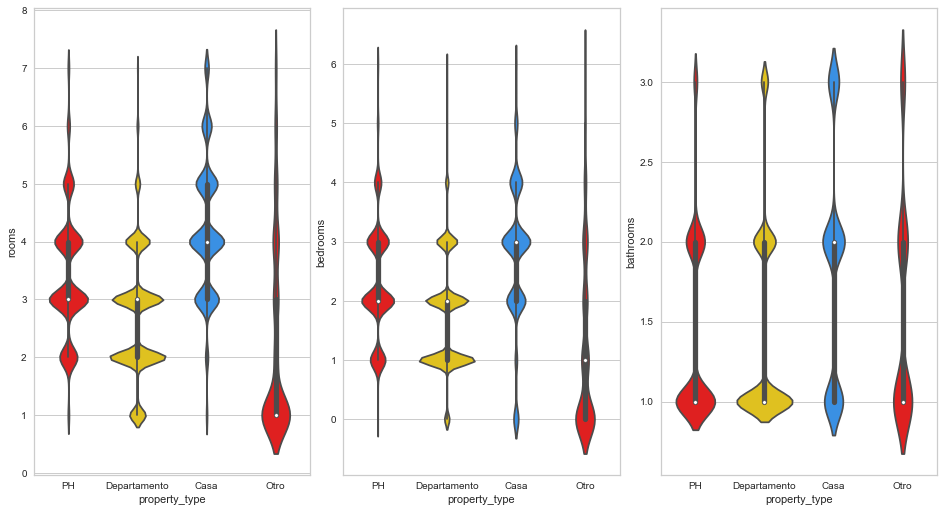

In [23]:
fig  = plt.figure(figsize = (13,7), constrained_layout = True)
grid = gridspec.GridSpec(1, 3, figure = fig)
ax1 = plt.subplot(grid[0])
sns.violinplot(x = "property_type",
               y = "rooms",
               data = properati,
               size = 9,
               palette = ['red','gold','dodgerblue'],
               orient='v')
ax2 = plt.subplot(grid[1])
sns.violinplot(x = "property_type",
               y = "bedrooms",
               data = properati,
               size = 9,
               palette = ['red','gold','dodgerblue'],
               orient ='v')
ax3 = plt.subplot(grid[2])
sns.violinplot(x = "property_type",
               y = "bathrooms",
               data = properati,
               size = 9,
               palette = ['red','gold','dodgerblue'],
               orient = 'v')
plt.show()

In order to identify and eliminate outliers, the IQR or Interquartile Range method was applied to the following instances: Rooms, Bathrooms and Bedrooms. An outlier was defined as a value 1.5 times the interquantile range below Q1 or above Q3.

The violinplot graph shows the final distribution after the cleaning of Outliers.

**SURFACE TOTAL - SURFACE COVERED**

In [24]:
properati.isna().sum()

lat                 9254
lon                 9286
l2                     0
l3                     0
rooms                  0
bedrooms               0
bathrooms           5915
surface_total      19608
surface_covered    20637
price                  0
property_type          0
dtype: int64

In [25]:
wrong_surface_rows = properati[properati['surface_total']<properati['surface_covered']]
wrong_surface_rows

,lat,lon,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,property_type
446,-34.613369,-58.488637,Capital Federal,Villa Santa Rita,5.0,4.0,3.0,230.0,244.0,490000.0,Casa
476,-34.779414,-58.391520,Bs.As. G.B.A. Zona Sur,Lomas de Zamora,4.0,2.0,1.0,148.0,11098.0,129000.0,Casa
602,-34.657972,-58.670631,Bs.As. G.B.A. Zona Oeste,Ituzaingó,1.0,1.0,1.0,32.0,33.0,65000.0,Departamento
783,-34.334050,-58.796940,Bs.As. G.B.A. Zona Norte,Escobar,3.0,2.0,1.0,33.0,187.0,115000.0,Casa
785,-34.681012,-58.375710,Bs.As. G.B.A. Zona Sur,Avellaneda,3.0,2.0,2.0,159.0,179.0,197000.0,Casa
...,...,...,...,...,...,...,...,...,...,...,...
145293,-34.763600,-58.405368,Bs.As. G.B.A. Zona Sur,Lomas de Zamora,3.0,2.0,2.0,72.0,73.0,185000.0,Departamento
145347,-34.648990,-58.603563,Bs.As. G.B.A. Zona Oeste,Morón,5.0,3.0,1.0,134.0,160.0,210000.0,Casa
145376,-34.650700,-58.385906,Capital Federal,Barracas,6.0,4.0,2.0,197.0,290.0,329900.0,Casa
145383,-34.647387,-58.388259,Capital Federal,Barracas,7.0,5.0,1.0,124.0,170.0,99000.0,Casa


It is proposed not to delete those instances where surface_total is less than surface_covered, but to exchange their values in case the aforementioned condition is met. Assuming that this error could have been caused by a human error at the time of registration in the platform.

In [26]:
properati.at[wrong_surface_rows.index, 'surface_total'] = wrong_surface_rows.surface_covered
properati.at[wrong_surface_rows.index, 'surface_covered'] = wrong_surface_rows.surface_total

In [27]:
properati.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,131029.000000,130997.000000,140283.000000,140283.000000,134368.000000,120675.000000,119646.000000,1.402830e+05
mean,-34.605221,-58.464414,2.951455,1.892638,1.477368,205.368593,96.482381,2.160467e+05
std,0.477803,0.494961,1.214148,1.033078,0.661683,2081.461696,737.610249,2.494822e+05
min,-35.318457,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,5.500000e+03
25%,-34.627828,-58.503468,2.000000,1.000000,1.000000,51.000000,46.000000,1.100000e+05
50%,-34.601088,-58.443262,3.000000,2.000000,1.000000,76.000000,65.000000,1.600000e+05
75%,-34.575673,-58.408031,4.000000,3.000000,2.000000,129.000000,100.000000,2.500000e+05
max,85.051129,-57.805832,7.000000,6.000000,3.000000,193549.000000,126062.000000,2.665353e+07


In [28]:
def remove_outlier2(df_in, col_name):
    Q1 = df_in[col_name].quantile(0.25)
    Q3 = df_in[col_name].quantile(0.75)
    IQR = Q3-Q1 #Interquartile range
    fence_low  = Q1-(1.5*IQR)
    fence_high = Q3+(1.2*IQR)
    df_out = df_in.drop(df_in[(df_in[col_name] > fence_high) | (df_in[col_name] < fence_low)].index)
    return df_out

Text(0.5, 1.0, 'Covered surface (m²)')

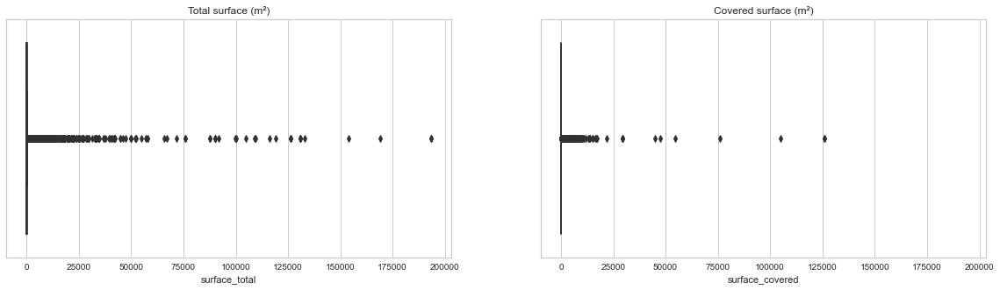

In [29]:
fig, axes = plt.subplots(1,2,sharex=True,figsize=(20,5))

sns.boxplot(ax=axes[0], x=properati['surface_total'])
axes[0].set_title('Total surface (m²)')

sns.boxplot(ax=axes[1], x=properati['surface_covered'])
axes[1].set_title('Covered surface (m²)')

In [30]:
properati = remove_outlier2(properati, 'surface_total')
properati = remove_outlier2(properati, 'surface_covered')

Text(0.5, 1.0, 'Covered surface (m²)')

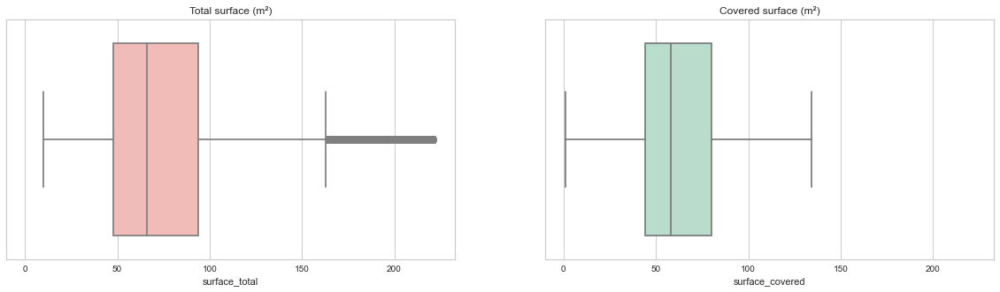

In [31]:
fig, axes = plt.subplots(1,2,sharex=True,figsize=(20,5))

sns.boxplot(ax=axes[0], x=properati['surface_total'], palette='Pastel1')
axes[0].set_title('Total surface (m²)')

sns.boxplot(ax=axes[1], x=properati['surface_covered'], palette='Pastel2')
axes[1].set_title('Covered surface (m²)')

In order to identify and eliminate outliers, the IQR or Interquartile Range method was applied to the surface_total and surface_covered instances. However, unlike the previous process, an outlier was defined as a value 1.5 times the interquantile range below Q1 and 1.2 times the interquantile range above Q3, since under the same criteria a large number of outliers were still present.

In [32]:
properati.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,111532.000000,111500.000000,119310.000000,119310.000000,114060.000000,99778.000000,99373.000000,1.193100e+05
mean,-34.603010,-58.458663,2.691702,1.684922,1.370305,75.248131,63.652199,1.854429e+05
std,0.514600,0.529764,1.017424,0.905058,0.586023,36.356795,25.626249,1.966563e+05
min,-35.123742,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,7.500000e+03
25%,-34.624487,-58.493467,2.000000,1.000000,1.000000,48.000000,44.000000,1.050000e+05
50%,-34.601070,-58.442222,3.000000,2.000000,1.000000,66.000000,58.000000,1.500000e+05
75%,-34.577413,-58.409620,3.000000,2.000000,2.000000,94.000000,80.000000,2.250000e+05
max,85.051129,-57.847990,7.000000,6.000000,3.000000,222.000000,134.000000,2.665353e+07


**PRICE**

<AxesSubplot:xlabel='price'>

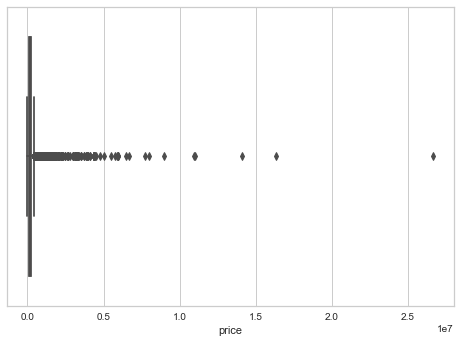

In [33]:
sns.boxplot(x=properati['price'], palette='Set1')

In [34]:
properati = remove_outlier2(properati, 'price')

<AxesSubplot:xlabel='price', ylabel='Count'>

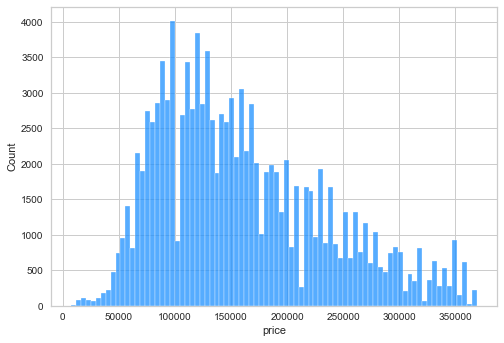

In [35]:
sns.histplot(x=properati['price'], color='dodgerblue')

In order to identify and eliminate outliers, the IQR or Interquartile Range method was applied to the instances: price. However, unlike the previous process, an outlier was defined as a value 1.5 times the interquantile range below Q1 and 1.2 times above Q3, since under the same criteria a large number of outliers were still present.

Highlighting the presence of properties within the dataset with a high cost affecting the distribution of the price variable.

In [36]:
properati.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,105150.000000,105120.000000,112149.000000,112149.000000,107570.000000,94371.000000,94008.000000,112149.000000
mean,-34.603619,-58.459626,2.641985,1.647433,1.315794,72.594515,61.388339,160298.956023
std,0.529570,0.545195,0.990163,0.876945,0.535951,34.883801,24.017022,74442.786316
min,-35.123742,-180.000000,1.000000,0.000000,1.000000,10.000000,1.000000,7500.000000
25%,-34.625479,-58.495942,2.000000,1.000000,1.000000,47.000000,43.000000,101500.000000
50%,-34.601793,-58.442761,3.000000,2.000000,1.000000,64.000000,56.000000,145000.000000
75%,-34.578578,-58.410860,3.000000,2.000000,2.000000,89.000000,75.000000,208500.000000
max,85.051129,-57.847990,7.000000,6.000000,3.000000,222.000000,134.000000,369000.000000


### Encoding ##

In [37]:
data_dummies_pt = pd.get_dummies(properati['property_type'])
data_dummies_pt

,Casa,Departamento,Otro,PH
1,0,0,0,1
2,0,0,0,1
3,0,0,0,1
4,0,0,0,1
5,0,0,0,1
...,...,...,...,...
146655,0,1,0,0
146656,0,1,0,0
146657,0,1,0,0
146658,0,1,0,0


In [38]:
data_dummies_l2 = pd.get_dummies(properati['l2'])

In [39]:
properati = (properati >> bind_cols(data_dummies_pt))
properati = (properati >> bind_cols(data_dummies_l2))

The property_type and l2 categorical variables were encoded using the Pandas get_dummies function. By handling this data conversion process, there is the advantage of not weighting a value unduly, nor hierarchizing it since these variables are considered to be of nominal type. On the other hand, more columns are added to the dataset increasing the dimensionality of the dataframe.

In [40]:
properati.shape

(112149, 19)

### Imputation of missing values ##

In [41]:
properati.isna().sum().sort_values(ascending = False)

surface_covered             18141
surface_total               17778
lon                          7029
lat                          6999
bathrooms                    4579
Departamento                    0
Bs.As. G.B.A. Zona Sur          0
Bs.As. G.B.A. Zona Oeste        0
Bs.As. G.B.A. Zona Norte        0
PH                              0
Otro                            0
price                           0
Casa                            0
property_type                   0
bedrooms                        0
rooms                           0
l3                              0
l2                              0
Capital Federal                 0
dtype: int64

In [42]:
properati.shape

(112149, 19)

In [43]:
properati.drop(['l2','l3','property_type'], axis = 'columns', inplace=True)

**Bathrooms Imputation**

In [44]:
properati_btho = (properati >> select(X.bathrooms))

In [45]:
simple = SimpleImputer(strategy='most_frequent')
properati_batrooms = simple.fit_transform(properati_btho)

Using the Sklearn SimpleImputer function, we proceeded to impute the missing values of the Bathrooms instance under the most frequent value method. With the purpose of not altering the distribution of the data to a great extent. 

In addition, it was taken into account that this is the instance with the lowest number of missing values, being 4579.

In [46]:
banos = pd.DataFrame(properati_batrooms, columns = ['bathrooms'])
banos.isna().sum()

bathrooms    0
dtype: int64

**Imputation surface_total - surface_covered**

In [47]:
properati_surface = (properati >> select(X.surface_total,X.surface_covered))

In [48]:
from sklearn.impute import KNNImputer

knn = KNNImputer(n_neighbors=5)
sf = knn.fit_transform(properati_surface)

Using the Sklearn KNNImputer function, we proceeded to impute the missing values of both the surface_total and surface_covered instances under the nearest neighbor method.

These instances are precisely the ones with the highest number of missing values, so it was decided to take advantage of this learning model which, although computationally more expensive, is much more accurate than the mean, median or mode. 

In [49]:
superficie = pd.DataFrame(sf, columns = ['surface_total','surface_covered'])
superficie.isna().sum()

surface_total      0
surface_covered    0
dtype: int64

In [50]:
print(properati.shape)
print(superficie.shape)
print(banos.shape)

(112149, 16)
(112149, 2)
(112149, 1)


In [51]:
properati = (properati >> select(~X.surface_total,~X.surface_covered,~X.bathrooms))

In [52]:
data = (superficie >> bind_cols(banos))

In [53]:
properati = properati.reset_index()
properati =properati.drop(['index'], axis = 'columns')

In [54]:
properati = (properati >> bind_cols(data))

In [55]:
properati

,lat,lon,rooms,bedrooms,price,Casa,Departamento,Otro,PH,Bs.As. G.B.A. Zona Norte,Bs.As. G.B.A. Zona Oeste,Bs.As. G.B.A. Zona Sur,Capital Federal,surface_total,surface_covered,bathrooms
0,-34.624056,-58.412110,2.0,1.0,159000.0,0,0,0,1,0,0,0,1,70.0,58.0,2.0
1,-34.593569,-58.427474,2.0,1.0,125000.0,0,0,0,1,0,0,0,1,45.0,45.0,1.0
2,-34.581294,-58.436754,2.0,1.0,295000.0,0,0,0,1,0,0,0,1,85.0,50.0,1.0
3,-34.914194,-57.938219,2.0,1.0,40000.0,0,0,0,1,0,0,1,0,50.0,35.0,1.0
4,-34.593779,-58.441239,2.0,1.0,150000.0,0,0,0,1,0,0,0,1,56.0,56.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112144,-34.816348,-58.181963,2.0,1.0,165000.0,0,1,0,0,0,0,1,0,54.0,48.0,1.0
112145,-34.446459,-58.937810,4.0,3.0,130000.0,0,1,0,0,1,0,0,0,164.0,90.0,2.0
112146,-34.444633,-58.981606,1.0,1.0,73000.0,0,1,0,0,1,0,0,0,50.0,35.0,1.0
112147,-34.444830,-58.981796,2.0,1.0,68000.0,0,1,0,0,1,0,0,0,38.0,38.0,1.0


**Remove null fields from variables Lat y Lon**

In [56]:
properati = properati.dropna()

In [57]:
properati.isna().sum()

lat                         0
lon                         0
rooms                       0
bedrooms                    0
price                       0
Casa                        0
Departamento                0
Otro                        0
PH                          0
Bs.As. G.B.A. Zona Norte    0
Bs.As. G.B.A. Zona Oeste    0
Bs.As. G.B.A. Zona Sur      0
Capital Federal             0
surface_total               0
surface_covered             0
bathrooms                   0
dtype: int64

In [58]:
properati.shape

(105120, 16)

In [59]:
properati.columns

Index(['lat', 'lon', 'rooms', 'bedrooms', 'price', 'Casa', 'Departamento',
       'Otro', 'PH', 'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
       'Bs.As. G.B.A. Zona Sur', 'Capital Federal', 'surface_total',
       'surface_covered', 'bathrooms'],
      dtype='object')

### Generation of new predictor variables ##

**Feature engineering**

In [60]:
properati = (properati >> mutate(price_m_2 = X.price/X.surface_total))

In [61]:
properati = (properati >> mutate(total_rooms = X.rooms + X.bedrooms + X.bathrooms))

In [62]:
properati.columns

Index(['lat', 'lon', 'rooms', 'bedrooms', 'price', 'Casa', 'Departamento',
       'Otro', 'PH', 'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
       'Bs.As. G.B.A. Zona Sur', 'Capital Federal', 'surface_total',
       'surface_covered', 'bathrooms', 'price_m_2', 'total_rooms'],
      dtype='object')

The creation of two new variables is considered.
The first variable called price_m_2, elaborated from the price and surface_total variables, which calculates the price of the property per square meter. And the second one called total_rooms, elaborated from the sum of the variables rooms, bedrooms and bathrooms to have an accumulated instance of rooms.

### Data scaling ##

In [63]:
from sklearn.preprocessing import StandardScaler

X = properati.drop(['price','lon','lat'], axis=1)
y = properati['price']

In [64]:
scl = StandardScaler()
X = scl.fit_transform(X)

In [65]:
data_transformada = pd.DataFrame(X, columns = ['rooms', 'bedrooms', 'Casa', 'Departamento',
       'Otro', 'PH', 'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
       'Bs.As. G.B.A. Zona Sur', 'Capital Federal', 'surface_total',
       'surface_covered', 'bathrooms', 'price_m_2', 'total_rooms'])

By means of Sklearn's StandardScaler function, the variables are standardized by eliminating the mean and scaling the variance by means of the Z-score calculated as:

$$ z = \frac{x-u}{s} $$

In [66]:
data_transformada.shape

(105120, 15)

In [67]:
data_transformada

,rooms,bedrooms,Casa,Departamento,Otro,PH,Bs.As. G.B.A. Zona Norte,Bs.As. G.B.A. Zona Oeste,Bs.As. G.B.A. Zona Sur,Capital Federal,surface_total,surface_covered,bathrooms,price_m_2,total_rooms
0,-0.649165,-0.737411,-0.258429,-2.112123,-0.127903,2.928696,-0.393378,-0.293555,-0.339901,0.681135,-0.072858,-0.146660,1.356723,-0.068090,-0.278395
1,-0.649165,-0.737411,-0.258429,-2.112123,-0.127903,2.928696,-0.393378,-0.293555,-0.339901,0.681135,-0.854971,-0.734196,-0.563576,0.498673,-0.754805
2,-0.649165,-0.737411,-0.258429,-2.112123,-0.127903,2.928696,-0.393378,-0.293555,-0.339901,0.681135,0.396410,-0.508221,-0.563576,1.274144,-0.754805
3,-0.649165,-0.737411,-0.258429,-2.112123,-0.127903,2.928696,-0.393378,-0.293555,2.942032,-1.468138,-0.698548,-1.186148,-0.563576,-1.715078,-0.754805
4,-0.649165,-0.737411,-0.258429,-2.112123,-0.127903,2.928696,-0.393378,-0.293555,-0.339901,0.681135,-0.510841,-0.237050,-0.563576,0.387630,-0.754805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105115,-0.649165,-0.737411,-0.258429,0.473457,-0.127903,-0.341449,-0.393378,-0.293555,2.942032,-1.468138,-0.573410,-0.598611,-0.563576,0.809593,-0.754805
105116,1.369568,1.539477,-0.258429,0.473457,-0.127903,-0.341449,2.542086,-0.293555,-0.339901,-1.468138,2.867888,1.299585,1.356723,-1.723268,1.627245
105117,-1.658531,-0.737411,-0.258429,0.473457,-0.127903,-0.341449,2.542086,-0.293555,-0.339901,-1.468138,-0.698548,-1.186148,-0.563576,-0.976332,-1.231216
105118,-0.649165,-0.737411,-0.258429,0.473457,-0.127903,-0.341449,2.542086,-0.293555,-0.339901,-1.468138,-1.073963,-1.050562,-0.563576,-0.607548,-0.754805


### Dimensionality reduction ##

**Principal component analysis (PCA)**

Text(0.5, 0.85, '95% cut-off threshold')

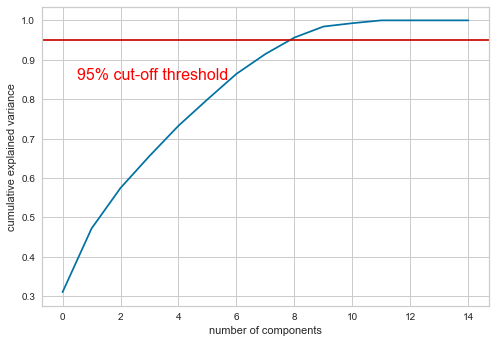

In [68]:
from sklearn.decomposition import PCA

pca = PCA().fit(X)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)

From the above graph it is determined that to obtain 95% of the variance explained, 8 principal components are needed.

In [69]:
pca = PCA(n_components=8)
X_nuevo = pca.fit_transform(X)

In [70]:
X_nuevo[0]

array([ 0.38476952, -0.70676476, -2.80199005, -1.0764181 ,  0.75646213,
        1.35675946, -0.20033081,  0.72325826])

In [71]:
principalDf = pd.DataFrame(data = X_nuevo, columns = ['principal component 1', 'principal component 2','principal component 3','principal component 4','principal component 5','principal component 6','principal component 7','principal component 8'])

In [72]:
principalDf

,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6,principal component 7,principal component 8
0,0.384770,-0.706765,-2.801990,-1.076418,0.756462,1.356759,-0.200331,0.723258
1,-0.921043,-0.935352,-3.177088,-1.024262,0.420891,1.803989,-0.572818,0.655266
2,-0.435652,-0.717643,-3.118590,-1.019590,0.657903,1.858870,-0.424854,0.391169
3,-0.507875,-3.928348,-2.106379,0.108073,0.979975,0.036933,-2.096532,2.160495
4,-0.585264,-0.974219,-3.178919,-1.107824,0.512175,1.508729,-0.547015,0.436472
...,...,...,...,...,...,...,...,...
105115,-1.545422,-1.412493,0.985750,1.753430,0.769289,-0.271565,-1.239441,1.679223
105116,3.989236,-0.269660,2.480466,-2.047186,0.957391,-1.358330,0.029048,-0.543230
105117,-2.287003,-1.668388,1.869671,-1.984320,0.696329,0.221525,-0.313018,-0.372061
105118,-1.791433,-1.278277,1.968008,-1.759549,0.609181,0.562058,-0.323979,0.000901


In [73]:
principalDf.shape

(105120, 8)

In [74]:
# Plot components
varianza_pca = pca.explained_variance_
varianza_pca

array([4.65555389, 2.42055425, 1.54520713, 1.21645782, 1.15185714,
       1.00275417, 0.97242906, 0.75610702])

## IV. Data Modeling

### Evaluation metrics for the proposed models ##

To evaluate the models, the MAE (Mean Absolute Error), RMSE (Root Mean Squared Error) and R2 (R-Squared) metrics will be used.
- Mean Absolute Error (MAE): It is a metric that is more robust to outliers and does not over-analyze errors because all individual differences are weighted equally.

$$\frac{1}{n}\sum_{i=1}^{n}|y_i -\hat{y}_i|$$

- Root Mean Squared Error (RMSE): It is a metric that penalizes large errors. It is also sensitive to outliers.

$$\sqrt{\frac{1}{n}\sum_{i=1}^{n}(y_i -\hat{y}_i)^2}$$

- R-squared (R2): Known as the coefficient of determination, it measures the portion of the variance of the target variable that can be explained by the model. However, it does not indicate whether the model explains the variance because it is overfitted.

$$ R^2 = 1 - \frac{SSE}{SST} $$

- R^2	=	coefficient of determination
- SSE	=	sum of squares of residuals
- TSS	=	total sum of squares

Therefore, the Adjusted R-squared, which takes into account the complexity of the model, must be taken into account.

$$1 - \frac{(1 - R^2)(n-1)}{(n-k-1)}$$

- n = number of datapoints
- k = number of feature used

### Implementation ##

In [75]:
X_train, X_test, y_train, y_test = train_test_split(X_nuevo, y, test_size=0.33, random_state=42)

In [76]:
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(70430, 8) (70430,) (34690, 8) (34690,)


**Linear Regression Benchmark**

In [77]:
linear_regressor = LinearRegression()

In [78]:
linear_regressor.fit(X_train, y_train)

LinearRegression()

Linear regression obtains the slope and the ordinate to the origin.

In [79]:
print(linear_regressor.coef_, linear_regressor.intercept_)

[17549.40117016 23141.32312932  7418.26193207  5408.13290417
 13665.75953302 17699.95183631 11814.52673212  1446.52600699] 158964.26590868458


In [80]:
y_train_pred_lin = linear_regressor.predict(X_train)
y_test_pred_lin  = linear_regressor.predict(X_test)

In [81]:
# MAE
mae_train = mean_absolute_error(y_train, y_train_pred_lin)
mae_test  = mean_absolute_error(y_test, y_test_pred_lin)

In [82]:
print(f'The Mean Absolute Error in Linear Regression - Train: {mae_train}')
print(f'The Mean Absolute Error in Linear Regression - Test: {mae_test}')

The Mean Absolute Error in Linear Regression - Train: 33618.02686471191
The Mean Absolute Error in Linear Regression - Test: 33696.76551529688


In [83]:
# RMSE
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred_lin))
rmse_test  = np.sqrt(mean_squared_error(y_test, y_test_pred_lin))

In [84]:
print(f'Root Mean Square Error in Linear Regression - Train: {rmse_train}')
print(f'Root Mean Square Error in Linear Regression - Test: {rmse_test}')

Root Mean Square Error in Linear Regression - Train: 44003.48091742121
Root Mean Square Error in Linear Regression - Test: 44155.82933322158


In [85]:
# R2
r2_train = metrics.r2_score(y_train, y_train_pred_lin)
r2_test  = metrics.r2_score(y_test, y_test_pred_lin)

In [86]:
print(f'The coefficient of determination R2 in Linear Regression - Train: {r2_train}')
print(f'The coefficient of determination R2 in Linear Regression - Test: {r2_test}')

The coefficient of determination R2 in Linear Regression - Train: 0.6447121800271187
The coefficient of determination R2 in Linear Regression - Test: 0.6419524103999259


In [87]:
# Adjusted R2
adj_r2_train = 1 - ((1 - r2_train) * (len(y_train) - 1)) / (len(y_train) - X_train.shape[1] - 1)
adj_r2_test  = 1 - ((1 - r2_test) * (len(y_test) - 1)) / (len(y_test) - X_test.shape[1] - 1)

In [88]:
print(f'Adjusted coefficient of determination in Linear Regression - Train: {adj_r2_train}')
print(f'Adjusted coefficient of determination in Linear Regression - Test: {adj_r2_test}')

Adjusted coefficient of determination in Linear Regression - Train: 0.6446718184508875
Adjusted coefficient of determination in Linear Regression - Test: 0.6418698181818007


Once the benchmarking model with comparison point has been performed, a nearest neighbor model and a decision tree model with initial hyperparameters of your choice are trained.

**Decision Tree**

In [89]:
arbol_regressor = DecisionTreeRegressor(random_state = 42)

In [90]:
arbol_regressor.fit(X_train, y_train)

DecisionTreeRegressor(random_state=42)

In [91]:
y_arbol_pred_train = arbol_regressor.predict(X_train)
y_arbol_pred_test  = arbol_regressor.predict(X_test)

In [92]:
# MAE
arbol_mae_train = mean_absolute_error(y_train,y_arbol_pred_train)
arbol_mae_test  = mean_absolute_error(y_test,y_arbol_pred_test)

In [93]:
print(f'The Mean Absolute Error in Decision Tree - Train: {arbol_mae_train}')
print(f'The Mean Absolute Error in Decision Tree - Test:  {arbol_mae_test}')

The Mean Absolute Error in Decision Tree - Train: 0.0
The Mean Absolute Error in Decision Tree - Test:  6664.301326030556


In [94]:
# RMSE
arbol_rmse_train = np.sqrt(mean_squared_error(y_train,y_arbol_pred_train))
arbol_rmse_test  = np.sqrt(mean_squared_error(y_test,y_arbol_pred_test))

In [95]:
print(f'Root mean square error in Decision Tree - Train: {arbol_rmse_train}')
print(f'Root mean square error in Decision Tree - Test:  {arbol_rmse_test}')

Root mean square error in Decision Tree - Train: 0.0
Root mean square error in Decision Tree - Test:  17553.509845715533


In [96]:
# R2
arbol_r2_train = metrics.r2_score(y_train, y_arbol_pred_train)
arbol_r2_test  = metrics.r2_score(y_test, y_arbol_pred_test)

In [97]:
print(f'The coefficient of determination R2 in Decision Tree - Train: {arbol_r2_train}')
print(f'The coefficient of determination R2 in Decision Tree- Test: {arbol_r2_test}')

The coefficient of determination R2 in Decision Tree - Train: 1.0
The coefficient of determination R2 in Decision Tree- Test: 0.9434161366047554


In [98]:
# Adjusted R2
arbol_adj_r2_train = 1 - ((1 - arbol_r2_train) * (len(y_train) - 1)) / (len(y_train) - X_train.shape[1] - 1)
arbol_adj_r2_test  = 1 - ((1 - arbol_r2_test) * (len(y_test) - 1)) / (len(y_test) - X_test.shape[1] - 1)

In [99]:
print(f'The adjusted coefficient of determination in Decision Tree - Train: {arbol_adj_r2_train}')
print(f'The adjusted coefficient of determination in Decision Tree - Test: {arbol_adj_r2_test}')

The adjusted coefficient of determination in Decision Tree - Train: 1.0
The adjusted coefficient of determination in Decision Tree - Test: 0.9434030841867985


**K Nearest Neighbors Regressor**

In [100]:
knn_regressor = KNeighborsRegressor()

In [101]:
knn_regressor.fit(X_train, y_train)

KNeighborsRegressor()

In [102]:
y_knn_pred_train = knn_regressor.predict(X_train)
y_knn_pred_test  = knn_regressor.predict(X_test)

In [103]:
# MAE
knn_mae_train = mean_absolute_error(y_train,y_knn_pred_train)
knn_mae_test  = mean_absolute_error(y_test,y_knn_pred_test)

In [104]:
print(f'The Mean Absolute Error in K Nearest Neighbors - Train: {knn_mae_train}')
print(f'The Mean Absolute Error in K Nearest Neighbors - Test:  {knn_mae_test}')

The Mean Absolute Error in K Nearest Neighbors - Train: 5371.023032798523
The Mean Absolute Error in K Nearest Neighbors - Test:  7043.817376765639


In [105]:
# RMSE
knn_rmse_train = np.sqrt(mean_squared_error(y_train,y_knn_pred_train))
knn_rmse_test  = np.sqrt(mean_squared_error(y_test,y_knn_pred_test))

In [106]:
print(f'Root Mean Square Error in K Nearest Neighbors - Train: {knn_rmse_train}')
print(f'Root Mean Square Error in K Nearest Neighbors - Test:  {knn_rmse_test}')

Root Mean Square Error in K Nearest Neighbors - Train: 11487.544445149666
Root Mean Square Error in K Nearest Neighbors - Test:  14766.39602567395


In [107]:
# R2
knn_r2_train = metrics.r2_score(y_train, y_knn_pred_train)
knn_r2_test  = metrics.r2_score(y_test, y_knn_pred_test)

In [108]:
print(f'The coefficient of determination R2 in K Nearest Neighbors - Train: {knn_r2_train}')
print(f'The coefficient of determination R2 in K Nearest Neighbors - Test: {knn_r2_test}')

The coefficient of determination R2 in K Nearest Neighbors - Train: 0.9757863275782986
The coefficient of determination R2 in K Nearest Neighbors - Test: 0.959958191368188


In [109]:
# Adjusted R2
knn_adj_r2_train = 1 - ((1 - knn_r2_train) * (len(y_train) - 1)) / (len(y_train) - X_train.shape[1] - 1)
knn_adj_r2_test  = 1 - ((1 - knn_r2_test) * (len(y_test) - 1)) / (len(y_test) - X_test.shape[1] - 1)

In [110]:
print(f'The adjusted coefficient of determination in K Nearest Neighbors - Train: {knn_adj_r2_train}')
print(f'The adjusted coefficient of determination in K Nearest Neighbors - Test: {knn_adj_r2_test}')

The adjusted coefficient of determination in K Nearest Neighbors - Train: 0.9757835768451456
The adjusted coefficient of determination in K Nearest Neighbors - Test: 0.9599489547697897


Modelo: Linear Regression
----------------------------------------
MAE in train is:  33618.02686471191
MAE in test is:  33696.76551529688
----------------------------------------
RMSE in train :  44003.48091742121
RMSE in test :  44155.82933322158
----------------------------------------
R2 in train :  0.6447121800271187
R2 adjusted in train :  0.6446718184508875
----------------------------------------
R2 in test :  0.6419524103999259
R2 adjusted in test :  0.6418698181818007
----------------------------------------


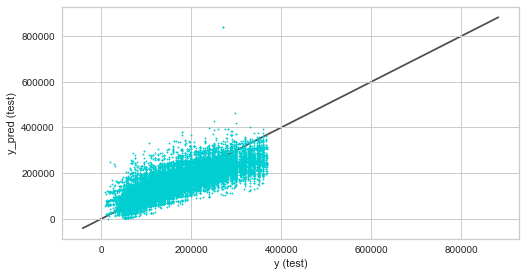

Modelo: Decision Tree
----------------------------------------
MAE in train is:  0.0
MAE in test is:  6664.301326030556
----------------------------------------
RMSE in train :  0.0
RMSE in test :  17553.509845715533
----------------------------------------
R2 in train :  1.0
R2 adjusted in train :  1.0
----------------------------------------
R2 in test :  0.9434161366047554
R2 adjusted in test :  0.9434030841867985
----------------------------------------


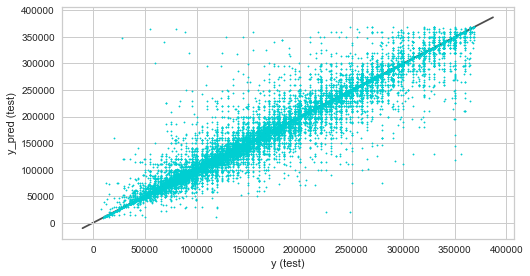

Modelo: K Nearest Neighbors
----------------------------------------
MAE in train is:  5371.023032798523
MAE in test is:  7043.817376765639
----------------------------------------
RMSE in train :  11487.544445149666
RMSE in test :  14766.39602567395
----------------------------------------
R2 in train :  0.9757863275782986
R2 adjusted in train :  0.9757835768451456
----------------------------------------
R2 in test :  0.959958191368188
R2 adjusted in test :  0.9599489547697897
----------------------------------------


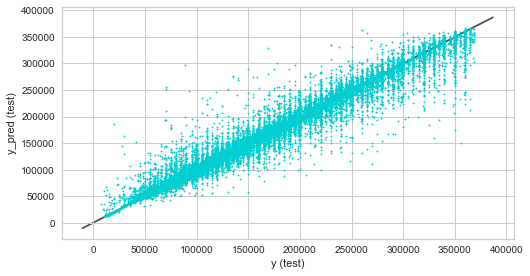

In [111]:
models = ['Linear Regression', 'Decision Tree', 'K Nearest Neighbors']

for i, model in enumerate([linear_regressor, arbol_regressor, knn_regressor]):
    y_train_pred = model.predict(X_train)
    y_test_pred  = model.predict(X_test)
    
    print(f'Modelo: {models[i]}')
    print("----------------------------------------")
    
    r2_train = metrics.r2_score(y_train, y_train_pred)
    r2_test  = metrics.r2_score(y_test, y_test_pred)
    
    adj_r2_train = 1 - ((1 - r2_train) * (len(y_train) - 1)) / (len(y_train) - X_train.shape[1] - 1)
    adj_r2_test  = 1 - ((1 - r2_test) * (len(y_test) - 1)) / (len(y_test) - X_test.shape[1] - 1)
    
    rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
    rmse_test  = np.sqrt(mean_squared_error(y_test, y_test_pred))
    
    mae_train = mean_absolute_error(y_train, y_train_pred)
    mae_test  = mean_absolute_error(y_test, y_test_pred)

    print("MAE in train is: ",mae_train)
    print("MAE in test is: ",mae_test)
    print("----------------------------------------")

    print("RMSE in train : ",rmse_train)
    print("RMSE in test : ",rmse_test)
    print("----------------------------------------")
    
    print("R2 in train : ",r2_train)
    print("R2 adjusted in train : ",adj_r2_train)
    print("----------------------------------------")
    
    print("R2 in test : ",r2_test)
    print("R2 adjusted in test : ",adj_r2_test)
    print("----------------------------------------")
    
    
    plt.figure(figsize = (14,4))
   
    ax = plt.subplot(1,2,2)
    ax.scatter(y_test,y_test_pred, s = 2, c = "darkturquoise")
    
    lims = [
    np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
    np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes]
    ]
    
    ax.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
    plt.xlabel('y (test)')
    plt.ylabel('y_pred (test)')
    
    plt.tight_layout()
    plt.show()

### Summary of results 

**Linear Regression Benchmark**

In [112]:
print("----------------------------------------------------------------------------------")
print("Train")
print("----------------------------------------------------------------------------------")

linear_trai = PrettyTable()
linear_trai.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
linear_trai.add_row([33618.0268, 44003.4809, 0.6447, 0.6446])
print(linear_trai)

print("----------------------------------------------------------------------------------")
print("Test")
print("----------------------------------------------------------------------------------")

linear_tes = PrettyTable()
linear_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
linear_tes.add_row([33696.7655, 44155.8293, 0.6419, 0.6418])
print(linear_tes)

----------------------------------------------------------------------------------
Train
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+--------------------+
|      33618.0268     |        44003.4809       |   0.6447  |       0.6446       |
+---------------------+-------------------------+-----------+--------------------+
----------------------------------------------------------------------------------
Test
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+---------------

**Decision Tree Regressor**

In [113]:
print("----------------------------------------------------------------------------------")
print("Train")
print("----------------------------------------------------------------------------------")

tree_tra = PrettyTable()
tree_tra.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
tree_tra.add_row([0.0, 0.0, 1.0, 1.0])
print(tree_tra)

print("----------------------------------------------------------------------------------")
print("Test")
print("----------------------------------------------------------------------------------")

tree_tes = PrettyTable()
tree_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
tree_tes.add_row([6664.3013, 17553.5098, 0.9434, 0.9434])
print(tree_tes)

----------------------------------------------------------------------------------
Train
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+--------------------+
|         0.0         |           0.0           |    1.0    |        1.0         |
+---------------------+-------------------------+-----------+--------------------+
----------------------------------------------------------------------------------
Test
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+---------------

**K Nearest Neighbors Regressor**

In [114]:
print("----------------------------------------------------------------------------------")
print("Train")
print("----------------------------------------------------------------------------------")

knn_tra = PrettyTable()
knn_tra.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
knn_tra.add_row([5371.3309, 11488.1811, 0.9757, 0.9757])
print(knn_tra)

print("----------------------------------------------------------------------------------")
print("Test")
print("----------------------------------------------------------------------------------")

knn_tes = PrettyTable()
knn_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Adjusted R-Squared"]
knn_tes.add_row([7044.8339, 14766.7155, 0.9599, 0.9599])
print(knn_tes)

----------------------------------------------------------------------------------
Train
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+--------------------+
|      5371.3309      |        11488.1811       |   0.9757  |       0.9757       |
+---------------------+-------------------------+-----------+--------------------+
----------------------------------------------------------------------------------
Test
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Adjusted R-Squared |
+---------------------+-------------------------+-----------+---------------

### Implementation Advanced Models ##

Next, three advanced Machine Learning models are implemented, being respectively Linear Regression with polynomial attributes - Ridge Regularization, Random Forest Regressor and XGBoost Regressor, with their default hyperparameters and cross validation by means of the Sklearn function cross_val_score.

**Linear regression with polynomial attributes**

In [115]:
poly = PolynomialFeatures(include_bias=False)
X_new = poly.fit_transform(X_nuevo)

In [116]:
print(X_new.shape)

(105120, 44)


**Ridge Regularization**

In [117]:
from sklearn.linear_model import Ridge, Lasso
reg_ridge = Ridge(alpha= 0.1)

In [118]:
from sklearn.model_selection import cross_validate, cross_val_score
ridge_score = cross_validate(reg_ridge, X_new, y, cv=5)

In [119]:
ridge_score['test_score']

array([0.95147978, 0.95238993, 0.95028249, 0.94500127, 0.93524627])

In [120]:
print("Score de Ridge: %0.2f (+/- %0.2f)" % (mean(ridge_score['test_score']), (ridge_score['test_score']).std() * 2))

Score de Ridge: 0.95 (+/- 0.01)


In [121]:
ridge_score_2 = cross_val_score(reg_ridge, X_new, y, cv=5)

In [122]:
print(ridge_score_2)
print("Score de Ridge: %0.2f (+/- %0.2f)" % (ridge_score_2.mean(), ridge_score_2.std() * 2))

[0.95147978 0.95238993 0.95028249 0.94500127 0.93524627]
Score de Ridge: 0.95 (+/- 0.01)


**Random Forest Regressor**

In [123]:
from sklearn.ensemble import RandomForestRegressor
regr = RandomForestRegressor(max_depth=5)

In [124]:
random_score = cross_val_score(regr, X_nuevo, y, cv=5)

In [125]:
print(random_score)
print("Random Forest score: %0.2f (+/- %0.2f)" % (random_score.mean(), random_score.std() * 2))

[0.73519354 0.73075013 0.72899041 0.73153407 0.69254756]
Random Forest score: 0.72 (+/- 0.03)


**XGBoost Regressor**

In [126]:
gbm = xgb.XGBRegressor(verbosity=1)

In [127]:
xgb_score = cross_val_score(gbm, X_nuevo, y, cv=5)

In [128]:
print(xgb_score)
print("Score de Random Forest: %0.2f (+/- %0.2f)" % (xgb_score.mean(), xgb_score.std() * 2))

[0.95692411 0.95836597 0.95734467 0.96123941 0.95836677]
Score de Random Forest: 0.96 (+/- 0.00)


The model with the best performance for the above conditions (cross-validation and default hyperparameters) is the XGBoost Regressor, followed closely by the Polynomial Regression with Ridge regularization.

### Optimization Advanced Models ##

In [129]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, max_error, median_absolute_error, r2_score, explained_variance_score

def regression_report(y_true, y_pred):
    
    error = y_true - y_pred
    percentil = [5,25,50,75,95]
    percentil_value = np.percentile(error, percentil)
    
    metrics = [
        ('mean absolute error', mean_absolute_error(y_true, y_pred)),
        ('root mean square error', np.sqrt(mean_squared_error(y_true, y_pred))), 
        ('median absolute error', median_absolute_error(y_true, y_pred)),
        ('mean squared error', mean_squared_error(y_true, y_pred)),
        ('max error', max_error(y_true, y_pred)),
        ('r2 score', r2_score(y_true, y_pred)),
        ('explained variance score', explained_variance_score(y_true, y_pred))
    ]
    
    print('Metrics for regression:')
    for metric_name, metric_value in metrics:
        print(f'{metric_name:>25s}: {metric_value: >20.3f}')
        
    print('\nPercentiles:')
    for p, pv in zip(percentil, percentil_value):
        print(f'{p: 25d}: {pv:>20.3f}')

**Linear regression with polynomial attributes**

In [130]:
poly = PolynomialFeatures(degree=2)
X_train_new = poly.fit_transform(X_train)
X_test_new  = poly.fit_transform(X_test)
print(X_train_new.shape)
print(X_test_new.shape)

(70430, 45)
(34690, 45)


In [131]:
# prepare a range of alpha values to test
alphas = np.array([1,0.1,0.01,0.001,0.0001,0])

In [132]:
# Grid Search
model = GridSearchCV(reg_ridge, param_grid=dict(alpha=alphas), cv=5)
# Polynomial regression with the grid defined above and CV with Fold size=5
model.fit(X_train_new, y_train)

GridSearchCV(cv=5, estimator=Ridge(alpha=0.1),
             param_grid={'alpha': array([1.e+00, 1.e-01, 1.e-02, 1.e-03, 1.e-04, 0.e+00])})

In [133]:
print("Best parameters: "+str(model.best_params_))
print("Best Score: "+str(model.best_score_)+'\n')

scores = pd.DataFrame(model.cv_results_)
scores

Best parameters: {'alpha': 0.0}
Best Score: 0.9484332827221446



,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.041002,0.002576,0.002997,0.001093,1.0,{'alpha': 1.0},0.949120,0.947525,0.949404,0.946410,0.949641,0.948420,0.001248,6
1,0.039527,0.003229,0.002402,0.000498,0.1,{'alpha': 0.1},0.949093,0.947522,0.949442,0.946433,0.949675,0.948433,0.001251,5
2,0.041892,0.003954,0.002794,0.000746,0.01,{'alpha': 0.01},0.949089,0.947520,0.949445,0.946434,0.949678,0.948433,0.001252,4
3,0.043188,0.004128,0.002408,0.000503,0.001,{'alpha': 0.001},0.949088,0.947520,0.949445,0.946434,0.949678,0.948433,0.001252,3
4,0.042282,0.005774,0.002393,0.000486,0.0001,{'alpha': 0.0001},0.949088,0.947520,0.949445,0.946434,0.949678,0.948433,0.001252,2
5,0.251989,0.087038,0.002811,0.000751,0.0,{'alpha': 0.0},0.949089,0.947519,0.949446,0.946434,0.949678,0.948433,0.001252,1


In [134]:
# We predict on test data
prediction = model.predict(X_test_new)

In [135]:
# Regression Report
report = regression_report(y_test, prediction)
print("Regression Report:")
print(report)

Metrics for regression:
      mean absolute error:            11269.485
   root mean square error:            17382.461
    median absolute error:             7692.000
       mean squared error:        302149933.438
                max error:           680276.000
                 r2 score:                0.945
 explained variance score:                0.945

Percentiles:
                        5:           -22810.600
                       25:            -8420.000
                       50:            -1388.000
                       75:             6683.000
                       95:            27272.400
Regression Report:
None


**Random Forest Regressor**

In [136]:
ran_forest = RandomForestRegressor()

In [137]:
n_estimators = [10,11,12]
max_depth = [5, 8,9]
min_samples_split = [2, 5, 10, 15]
min_samples_leaf = [1, 2, 5, 10] 

param_dist = dict(n_estimators = n_estimators, 
                  max_depth    = max_depth,  
                  min_samples_split = min_samples_split, 
                  min_samples_leaf  = min_samples_leaf)

In [138]:
# Random Search
model = RandomizedSearchCV(ran_forest, param_dist, n_iter=10, cv=3)

# We train: Random Forest with the grid defined above and CV with Fold size=5
model.fit(X_train, y_train)

RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(),
                   param_distributions={'max_depth': [5, 8, 9],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15],
                                        'n_estimators': [10, 11, 12]})

In [139]:
print("Best parameters: "+str(model.best_params_))
print("Best Score: "+str(model.best_score_)+'\n')

scores = pd.DataFrame(model.cv_results_)
scores

Best parameters: {'n_estimators': 11, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_depth': 9}
Best Score: 0.8916733459269133



,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_min_samples_split,param_min_samples_leaf,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,2.372342,0.185118,0.025597,0.001245,10,15,1,9,"{'n_estimators': 10, 'min_samples_split': 15, ...",0.892968,0.886845,0.887247,0.889020,0.002796,5
1,1.482791,0.025563,0.013300,0.001244,10,15,2,5,"{'n_estimators': 10, 'min_samples_split': 15, ...",0.738499,0.721045,0.713674,0.724406,0.010410,9
2,2.535444,0.081962,0.029245,0.004026,11,10,2,9,"{'n_estimators': 11, 'min_samples_split': 10, ...",0.892023,0.889942,0.893055,0.891673,0.001295,1
3,2.256754,0.053118,0.026585,0.000487,11,10,10,9,"{'n_estimators': 11, 'min_samples_split': 10, ...",0.890413,0.892610,0.884986,0.889336,0.003204,4
4,2.389244,0.113741,0.028241,0.002071,11,2,10,9,"{'n_estimators': 11, 'min_samples_split': 2, '...",0.894072,0.892701,0.884151,0.890308,0.004390,3
5,2.465776,0.100584,0.028909,0.000796,12,2,1,9,"{'n_estimators': 12, 'min_samples_split': 2, '...",0.892892,0.889729,0.888775,0.890465,0.001760,2
6,2.178270,0.006876,0.024825,0.000925,12,2,1,8,"{'n_estimators': 12, 'min_samples_split': 2, '...",0.866656,0.866068,0.857675,0.863467,0.004102,8
7,1.554344,0.080553,0.016817,0.002261,12,5,10,5,"{'n_estimators': 12, 'min_samples_split': 5, '...",0.738741,0.718934,0.710107,0.722594,0.011973,10
8,2.175883,0.011740,0.024613,0.000454,12,10,5,8,"{'n_estimators': 12, 'min_samples_split': 10, ...",0.870771,0.864702,0.861192,0.865555,0.003957,7
9,2.203262,0.050269,0.027594,0.002352,11,2,5,9,"{'n_estimators': 11, 'min_samples_split': 2, '...",0.892068,0.890184,0.882292,0.888182,0.004235,6


In [140]:
# We predict on test data
prediction = model.predict(X_test)

In [141]:
# Regression Report
report = regression_report(y_test, prediction)
print("Regression Report:")
print(report)

Metrics for regression:
      mean absolute error:            15789.903
   root mean square error:            24687.690
    median absolute error:             9406.061
       mean squared error:        609482016.552
                max error:           235075.138
                 r2 score:                0.888
 explained variance score:                0.888

Percentiles:
                        5:           -35107.335
                       25:           -10849.194
                       50:            -1533.015
                       75:             7952.984
                       95:            40370.433
Regression Report:
None


**XGBoost Regressor**

In [142]:
xgb_model = xgb.XGBRegressor()

In [143]:
param_dist = {'objective':['reg:squarederror'],
              'learning_rate': [0.1], 
              'max_depth': [7,10,15,20],
              'min_child_weight': [10,15,20,25],
              'n_estimators': [30,40,50,60],
              "reg_alpha"   : [0.5,0.2,1],
              "reg_lambda"  : [2,3,5],
              "gamma"       : [1,2,3]}

In [144]:
# Random Search
model = RandomizedSearchCV(xgb_model, param_dist,n_iter=10, cv=3)

# XGBoost with the grid defined above and CV with size of Fold=5
model.fit(X_train, y_train)

RandomizedSearchCV(cv=3,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, gamma=None,
                                          gpu_id=None, importance_type='gain',
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n...
                                          random_state=None, reg_alpha=None,
                                          reg_lambda=None,
                                          scale_pos_we

In [145]:
print("Best parameters: "+str(model.best_params_))
print("Best Score: "+str(model.best_score_)+'\n')

scores = pd.DataFrame(model.cv_results_)
scores

Best parameters: {'reg_lambda': 3, 'reg_alpha': 0.5, 'objective': 'reg:squarederror', 'n_estimators': 50, 'min_child_weight': 15, 'max_depth': 20, 'learning_rate': 0.1, 'gamma': 2}
Best Score: 0.9653960414997499



,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_reg_lambda,param_reg_alpha,param_objective,param_n_estimators,param_min_child_weight,param_max_depth,param_learning_rate,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,5.635933,0.201610,0.039562,0.001694,3,1,reg:squarederror,50,15,15,0.1,2,"{'reg_lambda': 3, 'reg_alpha': 1, 'objective':...",0.963001,0.963759,0.964112,0.963624,0.000463,2
1,3.928134,0.144193,0.029584,0.003082,2,0.2,reg:squarederror,50,15,10,0.1,1,"{'reg_lambda': 2, 'reg_alpha': 0.2, 'objective...",0.955118,0.953908,0.955148,0.954725,0.000578,6
2,1.741491,0.088443,0.014976,0.000795,3,1,reg:squarederror,30,10,7,0.1,1,"{'reg_lambda': 3, 'reg_alpha': 1, 'objective':...",0.898945,0.899513,0.897843,0.898767,0.000693,9
3,5.008557,0.180024,0.045545,0.014393,5,1,reg:squarederror,40,20,20,0.1,2,"{'reg_lambda': 5, 'reg_alpha': 1, 'objective':...",0.956749,0.957178,0.956619,0.956849,0.000239,4
4,4.084540,0.177953,0.027911,0.002806,3,0.2,reg:squarederror,50,15,10,0.1,2,"{'reg_lambda': 3, 'reg_alpha': 0.2, 'objective...",0.953510,0.953662,0.953168,0.953446,0.000207,7
5,7.008877,0.216619,0.046210,0.000470,3,0.5,reg:squarederror,50,15,20,0.1,2,"{'reg_lambda': 3, 'reg_alpha': 0.5, 'objective...",0.965248,0.966124,0.964816,0.965396,0.000544,1
6,5.063650,0.209558,0.037898,0.003733,2,0.2,reg:squarederror,40,15,15,0.1,3,"{'reg_lambda': 2, 'reg_alpha': 0.2, 'objective...",0.959620,0.959939,0.959819,0.959793,0.000132,3
7,4.572154,0.183490,0.035238,0.006111,3,0.5,reg:squarederror,40,25,15,0.1,3,"{'reg_lambda': 3, 'reg_alpha': 0.5, 'objective...",0.954876,0.955800,0.956134,0.955603,0.000532,5
8,1.694413,0.018996,0.015823,0.000230,2,0.5,reg:squarederror,30,25,7,0.1,1,"{'reg_lambda': 2, 'reg_alpha': 0.5, 'objective...",0.899276,0.898152,0.897213,0.898213,0.000843,10
9,2.266979,0.036987,0.022141,0.005861,3,1,reg:squarederror,40,20,7,0.1,3,"{'reg_lambda': 3, 'reg_alpha': 1, 'objective':...",0.920470,0.922487,0.921418,0.921458,0.000824,8


In [146]:
# We predict on test data
prediction = model.predict(X_test)

In [147]:
# Regression Report
report = regression_report(y_test, prediction)
print("Regression Report:")
print(report)

Metrics for regression:
      mean absolute error:             6397.844
   root mean square error:            12379.380
    median absolute error:             2728.344
       mean squared error:        153249037.224
                max error:           218156.125
                 r2 score:                0.972
 explained variance score:                0.972

Percentiles:
                        5:           -13806.670
                       25:            -2224.086
                       50:              490.539
                       75:             3194.324
                       95:            18219.490
Regression Report:
None


In [148]:
print("----------------------------------------------------------------------------------")
print("Polynomial Regression")
print("----------------------------------------------------------------------------------")

lin_tes = PrettyTable()
lin_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Explained Variance Score"]
lin_tes.add_row([11269.485, 17382.461, 0.945, 0.945])
print(lin_tes)

----------------------------------------------------------------------------------
Polynomial Regression
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Explained Variance Score |
+---------------------+-------------------------+-----------+--------------------------+
|      11269.485      |        17382.461        |   0.945   |          0.945           |
+---------------------+-------------------------+-----------+--------------------------+


In [149]:
print("----------------------------------------------------------------------------------")
print("Random Forest Regressor")
print("----------------------------------------------------------------------------------")

ran_tes = PrettyTable()
ran_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Explained Variance Score"]
ran_tes.add_row([15573.695, 24455.834, 0.890, 0.890])
print(ran_tes)

----------------------------------------------------------------------------------
Random Forest Regressor
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Explained Variance Score |
+---------------------+-------------------------+-----------+--------------------------+
|      15573.695      |        24455.834        |    0.89   |           0.89           |
+---------------------+-------------------------+-----------+--------------------------+


In [150]:
print("----------------------------------------------------------------------------------")
print("XGBoost Regressor")
print("----------------------------------------------------------------------------------")

xgb_tes = PrettyTable()
xgb_tes.field_names = ["Mean Absolute Error", "Root Mean Squared Error", "R-Squared", "Explained Variance Score"]
xgb_tes.add_row([6898.257, 12692.680, 0.970, 0.970])
print(xgb_tes)

----------------------------------------------------------------------------------
XGBoost Regressor
----------------------------------------------------------------------------------
+---------------------+-------------------------+-----------+--------------------------+
| Mean Absolute Error | Root Mean Squared Error | R-Squared | Explained Variance Score |
+---------------------+-------------------------+-----------+--------------------------+
|       6898.257      |         12692.68        |    0.97   |           0.97           |
+---------------------+-------------------------+-----------+--------------------------+


After performing the hyperparameter optimization of the implemented advanced models, it is observed that the model with the best results according to the established metrics is XGBoost Regressor. 

1. For the Mean Absolute Error metric of this model, the difference with respect to the Random Forest Regressor model equals 8675,438.
2. For the Root Mean Squared Error metric of this model, the difference with respect to the Random Forest Regressor model equals 11763,154.
3. For the Mean Absolute Error metric of this model, the difference to the polynomial regression model equals 4371,228.
4. For the Root Mean Squared Error metric of this model, the difference to the polynomial regression model equals 4689,781.

## V. Evaluation - Model interpretation ##

In [151]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [152]:
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(70430, 15) (70430,) (34690, 15) (34690,)


**Linear regression with polynomial attributes***

In [153]:
poly = PolynomialFeatures(degree=2)
X_train_new = poly.fit_transform(X_train)
X_test_new  = poly.fit_transform(X_test)
print(X_train_new.shape)
print(X_test_new.shape)

(70430, 136)
(34690, 136)


In [154]:
regresion_ridge = Ridge(alpha= 0.1)
regresion_ridge.fit(X_train_new,y_train)

Ridge(alpha=0.1)

In [155]:
y_pred = regresion_ridge.predict(X_test_new)

In [156]:
print('intercept:', regresion_ridge.intercept_)

intercept: 168689.5808742599


In [157]:
print('coefficients:', regresion_ridge.coef_)

coefficients: [ 0.00000000e+00  5.69018680e-02 -2.70615693e-02  4.32765484e-03
 -1.72362305e-03  1.00389427e-04 -1.28117806e-03 -2.87599942e-04
 -8.14613470e-03 -9.99482582e-03  1.13097612e-02  7.45477674e+04
  1.50385164e+00  1.47227605e-01  6.46186276e+04  5.23525105e-02
 -6.24603813e-03 -1.19188824e-02 -2.29095526e-02  3.75850321e-03
 -1.58070127e-02  2.00461529e-02 -7.86563343e-03  1.98121352e-02
  1.79546940e-02 -1.75836735e-02  4.14540921e-02 -1.49439278e-02
 -8.41704562e-03  4.85750780e-02 -1.01672216e-02  6.96463187e-03
  2.48491815e-02 -1.10675094e-02  1.18958278e-02 -1.06275189e-02
 -3.45599281e-03 -3.63940245e-03 -1.85580150e-02  1.67740389e-02
  1.68801482e-02 -5.39982479e-02  1.70457752e-02 -2.43821544e-02
  1.26485079e-03  1.86038918e-02 -8.67959313e-03 -5.74420190e-04
 -1.13580409e-03 -1.82361455e-02  7.12386648e-03  1.03774071e-02
  2.33521995e-03 -8.55609883e-02  8.94095227e-02 -2.56341789e-02
  5.15098562e-02 -6.77461933e-03  2.80265307e-03 -3.12462863e-05
  3.2637660

**Random Forest Regressor**

In [158]:
regressor = RandomForestRegressor(n_estimators=10,random_state = 0)

In [159]:
regressor.fit(X_train, y_train)

RandomForestRegressor(n_estimators=10, random_state=0)

In [160]:
y_prediccion = regressor.predict(X_test)

In [161]:
y_prediccion

array([130000.,  97000.,  92999., ...,  80000., 159400., 100000.])

In [162]:
regressor.feature_importances_

array([2.30875173e-05, 1.43490462e-05, 6.58124938e-06, 7.88613276e-06,
       5.37691971e-07, 1.11069324e-05, 1.18880825e-05, 1.40420243e-05,
       4.44624799e-06, 1.22541089e-05, 3.03774305e-01, 2.71638606e-04,
       1.21997871e-05, 4.12614019e-01, 2.83221658e-01])

In [163]:
nombres = (['rooms', 'bedrooms', 'Casa', 'Departamento',
       'Otro', 'PH', 'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
       'Bs.As. G.B.A. Zona Sur', 'Capital Federal', 'surface_total',
       'surface_covered', 'bathrooms', 'price_m_2', 'total_rooms'])

In [164]:
nombres_columnas = pd.DataFrame(columns = nombres)

In [165]:
nombres_columnas.columns

Index(['rooms', 'bedrooms', 'Casa', 'Departamento', 'Otro', 'PH',
       'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
       'Bs.As. G.B.A. Zona Sur', 'Capital Federal', 'surface_total',
       'surface_covered', 'bathrooms', 'price_m_2', 'total_rooms'],
      dtype='object')

In [166]:
nombres_columnas = nombres_columnas.reset_index()

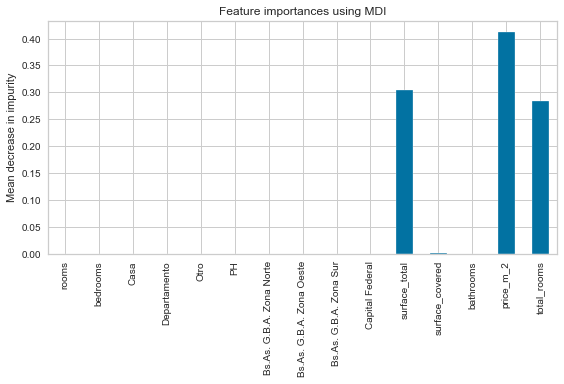

In [167]:
forest_importances = pd.Series(regressor.feature_importances_, index=nombres)
fig, ax = plt.subplots()
forest_importances.plot.bar(ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

According to the results obtained from the Random Forest Regressor, it is determined that the most relevant variables for this model are: price_m_2, surface_total and total_rooms, as shown in the previous graph. It should be noted that two of the most relevant variables were those constructed in the data transformation section, thus confirming the relevance of creating new variables from the initial instances of the dataset.

**XGBoost Regressor**

In [168]:
# Instantiation
xgb_r = xgb.XGBRegressor(objective ='reg:linear', n_estimators = 10, seed = 123)
  
# Fitting the model
xgb_r.fit(X_train, y_train)
  
# Predict the model
pred = xgb_r.predict(X_test)
  
# RMSE Computation
rmse = np.sqrt(mean_squared_error(y_test, pred))
print("RMSE : % f" %(rmse))

[21:14:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
RMSE :  7550.638324


In [169]:
# feature importance
print(xgb_r.feature_importances_)

[0.0000000e+00 1.1792435e-04 0.0000000e+00 3.0158685e-06 0.0000000e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 5.7508767e-02 1.2369284e-01 4.0573892e-01 7.1115166e-02 3.4182340e-01]


[0.0000000e+00 1.1792435e-04 0.0000000e+00 3.0158685e-06 0.0000000e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 5.7508767e-02 1.2369284e-01 4.0573892e-01 7.1115166e-02 3.4182340e-01]


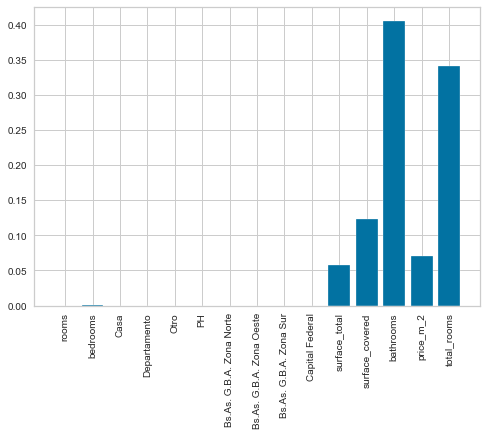

In [170]:
# feature importance
print(xgb_r.feature_importances_)
# plot
plt.bar(nombres, xgb_r.feature_importances_)
plt.xticks(rotation=90)
plt.show()

According to the results obtained from the XGBoost Regressor, the most relevant variables for this model are: bathrooms, total_rooms, surface_covered, price_m_2 and surface_total, as shown in the previous graph. It is worth noting that, unlike the Ramdom Forest Regressor model, the variable price_m_2, although it was important, was to a lesser extent. While the variable total_rooms was maintained.

### Distribution of errors by model

Text(0.5, 1.0, 'XGBoost Regressor')

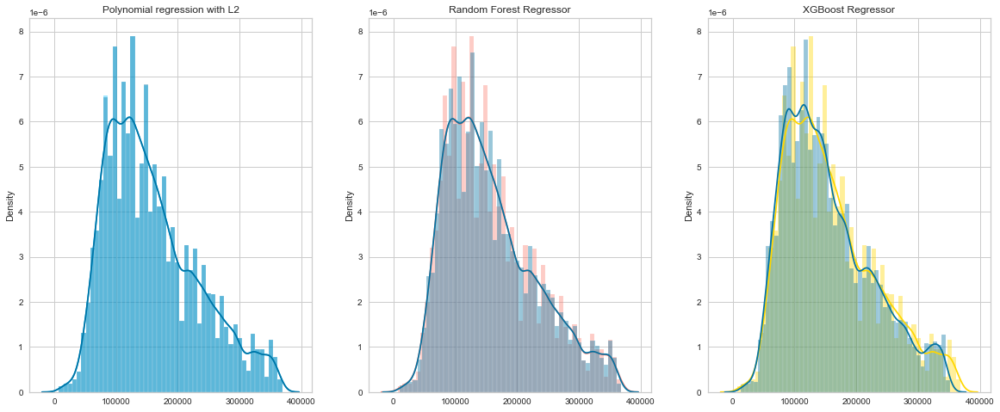

In [171]:
warnings.simplefilter(action="ignore", category=FutureWarning)

fig, axes = plt.subplots(1,3,sharex=True,figsize=(20,8))

sns.distplot(ax=axes[0], x= y_test, color='deepskyblue')
sns.distplot(ax=axes[0], x= y_pred)
axes[0].set_title('Polynomial regression with L2')

sns.distplot(ax=axes[1], x= y_test, color='salmon')
sns.distplot(ax=axes[1], x= y_prediccion)
axes[1].set_title('Random Forest Regressor')

sns.distplot(ax=axes[2], x= y_test, color='gold')
sns.distplot(ax=axes[2], x= pred)
axes[2].set_title('XGBoost Regressor')

Modelo: Random Forest Regressor
----------------------------------------
MAE in train is:  189.69951867102085
MAE in test is :  441.4170164312482
----------------------------------------
RMSE in train :  631.4585459841877
RMSE in test :  1745.1548981850488
----------------------------------------
R2 in train :  0.9999268362522331
R2 adjusted in train :  0.9999268206664659
----------------------------------------
R2 in test :  0.9994407157062618
R2 adjusted in test :  0.9994404737594311
----------------------------------------


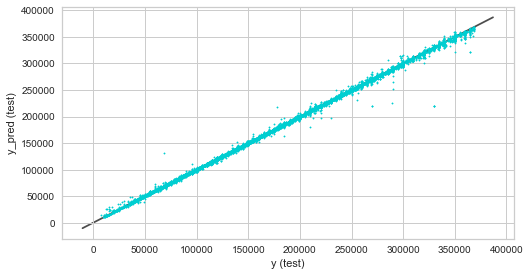

Modelo: XGBoost Regressor
----------------------------------------
MAE in train is:  5592.252518568969
MAE in test is :  5665.137263080138
----------------------------------------
RMSE in train :  7324.281081512146
RMSE in test :  7550.638323978711
----------------------------------------
R2 in train :  0.9901568011480815
R2 adjusted in train :  0.9901547042925871
----------------------------------------
R2 in test :  0.9895303539823825
R2 adjusted in test :  0.9895258248051816
----------------------------------------


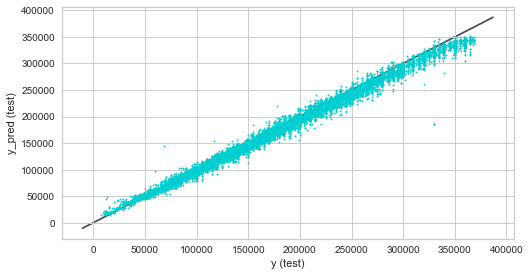

In [172]:
models = ['Random Forest Regressor', 'XGBoost Regressor']

for i, model in enumerate([regressor, xgb_r]):
    y_train_pred = model.predict(X_train)
    y_test_pred  = model.predict(X_test)
    
    print(f'Modelo: {models[i]}')
    print("----------------------------------------")
    
    r2_train = metrics.r2_score(y_train, y_train_pred)
    r2_test  = metrics.r2_score(y_test, y_test_pred)
    
    adj_r2_train = 1 - ((1 - r2_train) * (len(y_train) - 1)) / (len(y_train) - X_train.shape[1] - 1)
    adj_r2_test  = 1 - ((1 - r2_test) * (len(y_test) - 1)) / (len(y_test) - X_test.shape[1] - 1)
    
    rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
    rmse_test  = np.sqrt(mean_squared_error(y_test, y_test_pred))
    
    mae_train = mean_absolute_error(y_train, y_train_pred)
    mae_test  = mean_absolute_error(y_test, y_test_pred)

    print("MAE in train is: ",mae_train)
    print("MAE in test is : ",mae_test)
    print("----------------------------------------")

    print("RMSE in train : ",rmse_train)
    print("RMSE in test : ",rmse_test)
    print("----------------------------------------")
    
    print("R2 in train : ",r2_train)
    print("R2 adjusted in train : ",adj_r2_train)
    print("----------------------------------------")
    
    print("R2 in test : ",r2_test)
    print("R2 adjusted in test : ",adj_r2_test)
    print("----------------------------------------")
    
    
    plt.figure(figsize = (14,4))
   
    ax = plt.subplot(1,2,2)
    ax.scatter(y_test,y_test_pred, s = 2, c = "darkturquoise")
    
    lims = [
    np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
    np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes]
    ]
    
    ax.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
    plt.xlabel('y (test)')
    plt.ylabel('y_pred (test)')
    
    plt.tight_layout()
    plt.show()

 - In short, the selected advanced models have the capacity to explain the behavior of the data, as shown in the previous graphs, where the lines obtained are adjusted to the variation of the data.

### Clustering technique

In [173]:
properati_challenge =  pd.read_csv('DS_Proyecto_01_Datos_Properati.csv')

In [174]:
properati_challenge.head(3)

,start_date,end_date,created_on,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,title,description,property_type,operation_type
0,2019-10-17,2019-12-23,2019-10-17,-34.605880,-58.384949,Argentina,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,USD,"***Venta semipiso centro, ideal hostel*****",DESCRIPCION DE LA PROPIEDAD: Departamento de 1...,Departamento,Venta
1,2019-10-17,2019-11-21,2019-10-17,-34.624056,-58.412110,Argentina,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,USD,Espectacular PH reciclado en Boedo sin expensas.,PH reciclado en Boedo a una cuadra de la plaz...,PH,Venta
2,2019-10-17,2019-11-01,2019-10-17,-34.593569,-58.427474,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Pal...,"2 ambienets amplio , excelente estado , patio ...",PH,Venta


In [175]:
from dfply import *
properati_challenge = (properati_challenge >>
                       select(X.lat, X.lon, X.l2, X.l3, X.surface_total, X.price, X.property_type))

In [176]:
properati_challenge.shape

(146660, 7)

In [177]:
properati_challenge = properati_challenge.dropna()

In [178]:
properati_challenge.shape

(117579, 7)

In [179]:
properati_challenge['l2'].value_counts()

Capital Federal             78886
Bs.As. G.B.A. Zona Norte    19090
Bs.As. G.B.A. Zona Sur      10955
Bs.As. G.B.A. Zona Oeste     8648
Name: l2, dtype: int64

In [180]:
properati_challenge['l2'].value_counts().count()

4

In [181]:
properati_challenge['l3'].value_counts()

Palermo             11384
Almagro              6709
Tigre                6151
Villa Crespo         5910
Caballito            5627
                    ...  
Presidente Perón       73
Villa Soldati          67
Villa Riachuelo        39
Marcos Paz             24
Catalinas               5
Name: l3, Length: 89, dtype: int64

In [182]:
properati_challenge['l3'].value_counts().count()

89

### Kmeans applied to `lat` and `lon`

In [183]:
lat_lon = (properati_challenge >>
           select(X.lat, X.lon))

In [184]:
lat_lon.head(7)

,lat,lon
0,-34.605880,-58.384949
1,-34.624056,-58.412110
2,-34.593569,-58.427474
3,-34.581294,-58.436754
4,-34.914194,-57.938219
5,-34.593779,-58.441239
6,-34.600988,-58.433061


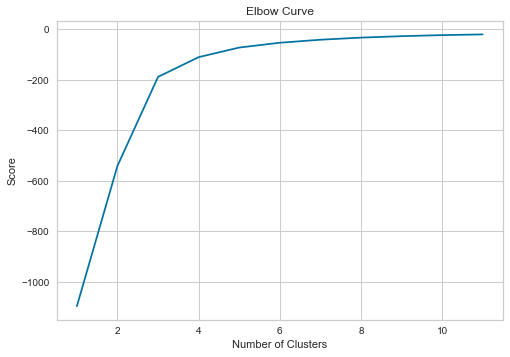

In [185]:
K_clusters = range(1,12)

kmeans = [KMeans(n_clusters=i) for i in K_clusters]
y_lat  = properati_challenge[['lat']]
X_lon  = properati_challenge[['lon']]
score  = [kmeans[i].fit(y_lat).score(y_lat) for i in range(len(kmeans))]

# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

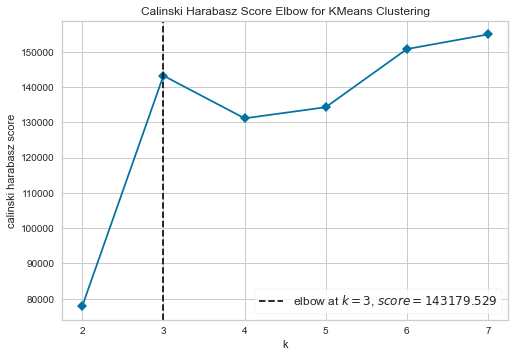

<AxesSubplot:title={'center':'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [186]:
# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(
    model, k=(2,8), metric='calinski_harabasz', timings=False, show=True
)

visualizer.fit(lat_lon)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [187]:
kmeans = KMeans(n_clusters = 3, init ='k-means++')
kmeans.fit(lat_lon[lat_lon.columns[0:2]]) # Compute k-means clustering.
lat_lon['cluster_label'] = kmeans.fit_predict(lat_lon[lat_lon.columns[0:2]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels  = kmeans.predict(lat_lon[lat_lon.columns[0:2]]) # Labels of each point
lat_lon.head(10)

,lat,lon,cluster_label
0,-34.605880,-58.384949,0
1,-34.624056,-58.412110,0
2,-34.593569,-58.427474,0
3,-34.581294,-58.436754,0
4,-34.914194,-57.938219,1
5,-34.593779,-58.441239,0
6,-34.600988,-58.433061,0
7,-34.600988,-58.433061,0
8,-34.639598,-58.419612,0
9,-34.639598,-58.419612,0


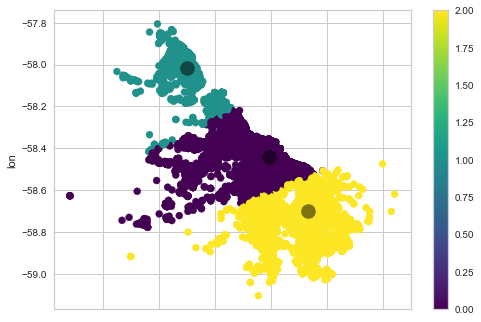

In [188]:
lat_lon.plot.scatter(x = 'lat', y = 'lon', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

In [189]:
kmeans = KMeans(n_clusters = 3, init ='k-means++')
kmeans.fit(properati_challenge[properati_challenge.columns[0:2]]) # Compute k-means clustering.
properati_challenge['lat_lon_clus'] = kmeans.fit_predict(properati_challenge[properati_challenge.columns[0:2]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels  = kmeans.predict(properati_challenge[properati_challenge.columns[0:2]]) # Labels of each point
properati_challenge.head(10)

,lat,lon,l2,l3,surface_total,price,property_type,lat_lon_clus
0,-34.605880,-58.384949,Capital Federal,San Cristobal,140.0,153000.0,Departamento,2
1,-34.624056,-58.412110,Capital Federal,Boedo,70.0,159000.0,PH,2
2,-34.593569,-58.427474,Capital Federal,Palermo,45.0,125000.0,PH,2
3,-34.581294,-58.436754,Capital Federal,Palermo,85.0,295000.0,PH,2
4,-34.914194,-57.938219,Bs.As. G.B.A. Zona Sur,La Plata,50.0,40000.0,PH,0
5,-34.593779,-58.441239,Capital Federal,Villa Crespo,56.0,150000.0,PH,2
6,-34.600988,-58.433061,Capital Federal,Villa Crespo,70.0,159500.0,PH,2
7,-34.600988,-58.433061,Capital Federal,Villa Crespo,70.0,159500.0,PH,2
8,-34.639598,-58.419612,Capital Federal,Parque Patricios,45.0,89000.0,PH,2
9,-34.639598,-58.419612,Capital Federal,Parque Patricios,45.0,89000.0,PH,2


In [190]:
properati_challenge["lat_lon_clus"].value_counts()

2    97407
1    16025
0     4147
Name: lat_lon_clus, dtype: int64

In [191]:
fig = px.scatter_mapbox(properati_challenge, 
                        lat="lat", lon="lon", color="lat_lon_clus",
                        hover_data=['price'],
                        animation_frame="l2",
                        zoom=10,
                        title="Mapa de Capital Federal para Departamentos, PH y Casa")

fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [192]:
l2_mean_price = (properati_challenge >>
                 group_by(X.l2)      >>
                 summarize(mean_price = X.price.mean()) >>
                 arrange(X.mean_price, ascending = True))

In [193]:
l2_mean_price.sort_values(by=['mean_price'])

,l2,mean_price
1,Bs.As. G.B.A. Zona Oeste,148530.245375
2,Bs.As. G.B.A. Zona Sur,164588.852670
0,Bs.As. G.B.A. Zona Norte,236599.771556
3,Capital Federal,258220.285171


In [194]:
l3_mean_price = (properati_challenge >>
                 group_by(X.l3)      >>
                 summarize(mean_price = mean(X.price)) >>
                 arrange(X.mean_price, ascending = False))

In [195]:
l3_mean_price.sort_values(by=['mean_price'])

,l3,mean_price
31,José C Paz,99208.759358
20,Constitución,105360.671875
86,Villa Soldati,123143.283582
4,Avellaneda,123376.366400
28,General San Martín,125302.425770
...,...,...
48,Palermo,357423.171908
8,Belgrano,368066.864713
60,Recoleta,410515.068344
35,Las Cañitas,447161.573052


- The previous analysis allows us to establish the Federal Capital and Bs. G.B.A. Zona Norte as the areas with the most expensive properties with average prices of USD \\$258,220 and USD \\$236,599, respectively. 

If the search is made in the Province of Buenos Aires, it will be found that:
- Puerto Madero (USD \\$988003)
- Las Cañitas (USD \\$447161) 
- Recoleta (USD \\$410515) are the most expensive places.

While in the cheapest areas we get to: 
- José C. Paz   (USD \\$99208) 
- Constitución  (USD \\$105360) 
- Villa Soldati (USD \\$123143)

## Conclusions

After this tour it is observed that the values according to the established evaluation metrics (MAE, RMSE, R2 and Adjusted R2) obtained from the models with the optimized hyperparameters improved their performance. However, the most important point that determines the success of the project is given by the cleaning and transformation of the data.

The creation of new variables from the dataset instances (feature engineering) plays an important role in the training of advanced models as it helps to condense more information, while reducing the dimensionality of the dataset for time and computational cost.

However, in these comparisons we can remark again that the best performing model was the XGBoost Regressor as it obtained the lowest Mean Absolute Error and Root Mean Squared Error for the test data tested here (with optimization and without optimization). On the other hand, the Random Forest Regressor model had the lowest performance compared to the other two models implemented.

### Next steps and future work to improve results achieved

- Evaluate different number of components and variables to determine the variation of metrics, according to the size of the dataset.

- Generate new variables from existing variables (synthetic variables) or add new data sources.

- Expand the range of models implemented to perform a more holistic analysis of the problem and even a combination of these models.

- Implement a visualization tool aimed at different audiences, in order to consolidate the results obtained and thus be presented in a clear way so that the user can manage and make decisions based on the data.